### Agentic Approach

This notebook implements our agentic video QA pipeline over long-form body-cam metadata. Given a user question and the full (or candidate) metadata table, an orchestrator LLM iteratively plans tool calls to:
 - select the most relevant time segments from metadata,
 - view/visualize those segments for evidence
 - ask a multimodal LLM (Gemini) targeted follow-up questions when the required detail is not explicitly present in the metadata.

 The agent loops until it gathers sufficient evidence, then returns a verified answer grounded in timestamps + retrieved rows + optional visual confirmation.

 ### Setup the following API Keys in google colab secrets:
  - LLM_API_ENDPOINT
 - LLM_API_DEPLOYMENT
 - LLM_API_KEY
 - LLM_API_VERSION
 - GEMINI_API_KEY

 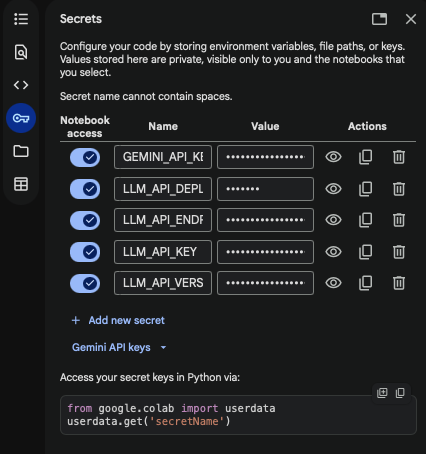


### Installation

In [1]:
%pip install --upgrade --quiet google-genai gitingest

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.7/47.7 kB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 262.0/262.0 kB 10.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 68.3/68.3 kB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.6/61.6 kB 1.9 MB/s eta 0:00:00


In [2]:
!pip install av

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.5/40.5 MB 15.0 MB/s eta 0:00:00


In [3]:
!pip install --quiet openai pandas sqlalchemy

### Step 1: Setting up GPT and Gemini API

In [4]:
import os
import json
from openai import AzureOpenAI
from dotenv import load_dotenv
from typing import List, Dict
from google.colab import userdata

# Azure OpenAI client
azure_endpoint   = userdata.get("LLM_API_ENDPOINT")
deployment_name  = userdata.get("LLM_API_DEPLOYMENT")
api_key          = userdata.get("LLM_API_KEY")
api_version      = userdata.get("LLM_API_VERSION")

gpt_client = AzureOpenAI(
    api_version=api_version,
    azure_endpoint=azure_endpoint,
    api_key=api_key,
)

print(f"Azure client initialized for deployment: {deployment_name}")

# --- Simple test ---
try:
    response = gpt_client.chat.completions.create(
        model=deployment_name,
        messages=[
            {"role": "system", "content": "You are a friendly assistant."},
            {"role": "user", "content": "Say 'hi' if you can read this."},
        ],
    )
    print("Model reply:", response.choices[0].message.content)
except Exception as e:
    print("Test request failed:", e)




Azure client initialized for deployment: gpt-4.1
Model reply: Hi! I can read your message. How can I help you today?


In [5]:
import google.generativeai as genai
from google.genai.types import Part

genai.configure(api_key=userdata.get("GEMINI_API_KEY"))

model = genai.GenerativeModel("gemini-2.5-flash")

def ask_gemini(question: str, video_path: str) -> str:
    try:
        with open(video_path, "rb") as f:
            video_bytes = f.read()
        print("Loaded bytes, asking gemini...")
        response = model.generate_content(
            [
                {"text": question},
                {"inline_data": {"mime_type": "video/mp4", "data": video_bytes}},
            ]
        )

        return response.text.strip()

    except Exception as e:
        print("❌ Gemini error:", e)
        return f"[Gemini error: {e}]"


### Utilities

In [7]:
# ========= Utilities =========
import os, re, json, hashlib
from typing import List, Dict, Optional
import pandas as pd
from moviepy.editor import VideoFileClip
from IPython.display import Video, display
import subprocess
import pandas as pd
import json

def read_csv_to_json(csv_path: str) -> list:
    df = pd.read_csv(csv_path)
    return json.loads(df.to_json(orient="records"))

# ---- Time helpers
def timestamp_to_seconds(t: str) -> int:
    m, s = map(int, re.findall(r"\d+", t))
    return m * 60 + s

def seconds_to_timestamp(sec: int) -> str:
    return f"{sec // 60:02}:{sec % 60:02}"

def get_video_duration(path: str) -> int:
    with VideoFileClip(path) as v:
        return int(v.duration)

# ---- Data helpers
def read_csv_to_json(csv_path: str) -> List[Dict]:
    df = pd.read_csv(csv_path)
    #remove summary column
    df = df.drop(columns=['summary'])
    return json.loads(df.to_json(orient="records"))

# ---- Paths & caching
BASE_SEGMENT_DIR = "/content/segments"
os.makedirs(BASE_SEGMENT_DIR, exist_ok=True)

from moviepy.editor import VideoFileClip
from IPython.display import display, HTML
import base64, mimetypes, pathlib, os

def make_segment_path(start_ts: str, end_ts: str, video_path: str) -> str:
    """
    Create a deterministic filename for the segment, namespaced by source video.
    Example: /content/segments/17-183-0765_BWC_Redacted-2__00-00_to_00-12.mp4
    """
    base = os.path.splitext(os.path.basename(video_path))[0]
    safe_start = start_ts.replace(":", "-")
    safe_end   = end_ts.replace(":", "-")
    fname = f"{base}__{safe_start}_to_{safe_end}.mp4"
    return os.path.join(BASE_SEGMENT_DIR, fname)

def calc_target_bitrate_kbps(target_mb: float, duration_sec: float) -> int:
    size_bits = target_mb * 8 * 1024 * 1024
    bps = size_bits / max(duration_sec, 0.1)
    return int(bps / 1000)  # kbps

def ensure_segment(
    video_path: str,
    start_sec: int,
    end_sec: int,
    out_path: str,
    show_vid: bool = False,
    target_mb: float = 25.0,   # desired ~size
) -> str:
    os.makedirs(os.path.dirname(out_path), exist_ok=True)

    if not os.path.exists(out_path):
        duration = max(0.1, end_sec - start_sec)
        v_kbps = calc_target_bitrate_kbps(target_mb * 0.8, duration)  # 80% video
        a_kbps = 32                                                  # 20% audio

        cmd = [
            "ffmpeg",
            "-y",
            "-ss", str(start_sec),
            "-t", str(duration),
            "-i", video_path,
            "-vf", "scale=640:-1,fps=10",

            "-c:v", "libx264",
            "-preset", "ultrafast",
            "-b:v", f"{v_kbps}k",

            "-c:a", "aac",
            "-b:a", f"{a_kbps}k",
            "-ac", "1",
            "-ar", "16000",


            "-movflags", "+faststart",
            out_path,
        ]

        print("Running ffmpeg:", " ".join(cmd))
        subprocess.run(cmd, check=True)

        size_mb = pathlib.Path(out_path).stat().st_size / (1024 * 1024)
        print(f"📦 Segment saved to {out_path} ({size_mb:.2f} MB) [target ~{target_mb} MB]")

    if show_vid:
        _display_with_audio(out_path)

    return out_path

def _display_with_audio(path: str, width: int = 640, max_inline_mb: int = 50):
    p = pathlib.Path(path)
    mime = mimetypes.guess_type(p.name)[0] or "video/mp4"
    size_mb = p.stat().st_size / (1024*1024)

    if size_mb <= max_inline_mb:
        # Inline base64 so it always works in Colab/Jupyter
        b64 = base64.b64encode(p.read_bytes()).decode("ascii")
        html = f'<video controls width="{width}" src="data:{mime};base64,{b64}"></video>'
    else:
        # Larger files → rely on notebook server
        html = f'<video controls width="{width}" src="{p.as_posix()}"></video>'
    display(HTML(html))


def show_segment(video_path: str, start_time: str, end_time: str,
                 show_vid: bool = True) -> str:
    s = timestamp_to_seconds(start_time)
    e = timestamp_to_seconds(end_time)
    seg_path = make_segment_path(start_time, end_time, video_path)
    return ensure_segment(video_path, s, e, seg_path, show_vid=show_vid)



### Agentic approach using States

In [8]:
from dataclasses import dataclass, field
from typing import Dict, List, Tuple, Optional
import json, hashlib

@dataclass
class State:
    user_question: str
    meta_json: List[Dict]                # parsed CSV-as-JSON
    last_gpt_question: Optional[str]=None
    last_gemini_answer: Optional[str] = None
    last_segment: Optional[Tuple[str,str]] = None  # (start_ts, end_ts)
    asked_cache: set = field(default_factory=set)  # {(q,start,end)}
    turn: int = 1

def _hash_qseg(q: str, a: Optional[Tuple[str,str]]) -> str:
    seg = a or ("", "")
    return hashlib.md5(f"{q}|{seg[0]}|{seg[1]}".encode()).hexdigest()

def _summarize(text: str, max_chars: int = 700) -> str:
    if not text: return ""
    t = text.strip()
    return (t[:max_chars] + "…") if len(t) > max_chars else t


In [9]:
function_specs = [
    {
        "name": "ask_gemini_on_segment",
        "description": "Ask Gemini a question about a specific video segment (≤10 minutes).",
        "parameters": {
            "type": "object",
            "properties": {
                "question":   {"type": "string"},
                "start_time": {"type": "string", "description": "mm:ss"},
                "end_time":   {"type": "string", "description": "mm:ss"}
            },
            "required": ["question", "start_time", "end_time"]
        },
    },
    {
        "name": "show_segment_and_answer",
        "description": "Show a segment and give the final answer.",
        "parameters": {
            "type": "object",
            "properties": {
                "start_time": {"type": "string"},
                "end_time":   {"type": "string"},
                "answer":     {"type": "string"}
            },
            "required": ["start_time", "end_time", "answer"]
        },
    },
    {
        "name": "finish",
        "description": "Return the final answer to the user.",
        "parameters": {
            "type": "object",
            "properties": {"answer": {"type": "string"}},
            "required": ["answer"]
        },
    },

]


In [10]:
def build_messages(state: State) -> List[Dict]:
    SYSTEM = (
        "You're an investigative intelligent assistant that answers user questions about a video from:\n"
        "1) structured event metadata (JSON), and 2) Gemini's visual analysis of segments.\n\n"
        "Policy:\n"
        "- First, check metadata; if sufficient → call finish(answer).\n"
        "- If missing/uncertain → call ask_gemini_on_segment(question,start_time,end_time) (≤5 min at a time). \n"
        "- There may be questions that require you to ask gemini questions for different segments for each turn. If that's the case, look at the previous ask_gemini_on_segment calls and make the next best decision.\n"
        "- If the user asked to SEE a moment → call show_segment_and_answer(start_time,end_time,answer).\n"
        "- If a Gemini answer already exists in THIS conversation, DO NOT ask Gemini again; synthesize and call finish.\n"
        "- Always explain reasoning briefly BEFORE the function call.\n"
    )

    if state.turn >= 4:
        SYSTEM += (
            "\n⚠️ You are on a later turn. You MUST provide your best final answer now. "
            "Do NOT call Gemini again. Call `finish(answer)`."
        )

    msgs = [
        {"role": "system", "content": SYSTEM},
        {"role": "user", "content": f"User question: {state.user_question}"}
    ]

    meta_str = json.dumps(state.meta_json[:3], indent=2)
    msgs.append({
        "role": "assistant",
        "content": f"Event metadata (excerpt):\n```json\n{meta_str}\n```"
    })

    if state.last_gemini_answer:
        seg_info = ""
        if state.last_segment:
            seg_info = f" (from segment {state.last_segment[0]}–{state.last_segment[1]})"
        msgs.append({
            "role": "assistant",
            "content": f"Gemini previously responded to your function call ask_gemini_on_segment({state.last_gpt_question}, {state.last_segment[0]},{state.last_segment[1]}):\n{_summarize(state.last_gemini_answer)}"
        })

    return msgs


def gpt_decide(state: State) -> Dict:
    messages = build_messages(state)
    resp = gpt_client.chat.completions.create(
        model=deployment_name,
        messages=messages,
        functions=function_specs,
        function_call="auto",
        temperature=0.0,   # deterministic; reduce re-asking
        top_p=1.0
    )
    msg = resp.choices[0].message
    if msg.content:
        print("\n🧠 GPT Reasoning:\n", msg.content.strip())
    return msg


In [11]:
def run_agentic_loop(VIDEO_PATH: str, CSV_PATH: str, QUESTION: str, max_turns: int = 5):
    print(f"\n🎯 User Question: {QUESTION}")
    event_data = read_csv_to_json(CSV_PATH)

    state = State(user_question=QUESTION, meta_json=event_data)

    video_duration = get_video_duration(VIDEO_PATH)

    for _ in range(max_turns):
        print(f"\n🔁 Turn {state.turn}")
        msg = gpt_decide(state)

        # If GPT just answered directly (no tool)
        if not msg.function_call:
            print("⚠️ No tool call; model said:\n", msg.content)
            # If we already have a Gemini answer, synthesize & stop
            if state.last_gemini_answer:
                print("\n✅ Final Answer (synthesized):", _summarize(state.last_gemini_answer, 900))
            break

        name = msg.function_call.name
        args = json.loads(msg.function_call.arguments or "{}")

        if name == "finish":
            print("\n✅ Final Answer:", args["answer"])
            break

        if name == "show_segment_and_answer":
            start, end, answer = args["start_time"], args["end_time"], args["answer"]
            # Clamp length & bounds
            s, e = timestamp_to_seconds(start), timestamp_to_seconds(end)
            if e > video_duration: e = video_duration
            if e <= s: e = min(s + 5, video_duration)
            if (e - s) > 300: e = s + 300
            start_ts, end_ts = seconds_to_timestamp(s), seconds_to_timestamp(e)

            # Show to the user (with audio)
            seg_path = make_segment_path(start_ts, end_ts, VIDEO_PATH)
            ensure_segment(VIDEO_PATH, s, e, seg_path, show_vid=True)

            print(f"\n✅ Final Answer: {answer}")
            break

        if name == "ask_gemini_on_segment":
            q, start, end = args["question"], args["start_time"], args["end_time"]
            print('GPT asking Gemini', f"{q}: {start}, {end}")
            # Convert to seconds for normalization
            s = timestamp_to_seconds(start)
            e = timestamp_to_seconds(end)

            # Normalize timestamps to canonical mm:ss
            start_ts = seconds_to_timestamp(s)
            end_ts   = seconds_to_timestamp(e)

            # ---- DEDUPE LOGIC ----

            # Hash of (question + normalized segment)
            dedupe_key = _hash_qseg(q, (start_ts, end_ts))

            # Check if this is the same segment as last Gemini call
            same_segment_as_before = (
                state.last_segment is not None and
                state.last_segment[0] == start_ts and
                state.last_segment[1] == end_ts and
                state.last_gpt_question == q
            )

            if (
                # dedupe_key in state.asked_cache      # same question+segment
                same_segment_as_before            # same segment as last call
                # or state.last_gemini_answer          # already have Gemini output
            ):
                print("ℹ️ Skipping duplicate Gemini call; finalizing.")
                print("\n✅ Final Answer:", _summarize(state.last_gemini_answer or "No additional info.", 900))
                break

            # Record this question+segment pair as asked
            state.asked_cache.add(dedupe_key)

            # Clamp for safety
            s, e = timestamp_to_seconds(start), timestamp_to_seconds(end)
            if e > video_duration: e = video_duration
            if e <= s: e = min(s + 5, video_duration)
            if (e - s) > 300: e = s + 300
            start_ts, end_ts = seconds_to_timestamp(s), seconds_to_timestamp(e)

            # Build / reuse segment (silent for Gemini)
            seg_path = make_segment_path(start_ts, end_ts, VIDEO_PATH)
            ensure_segment(VIDEO_PATH, s, e, seg_path, show_vid=False)

            q += f" Important to note: You are processing a segment from a full video. The segment has a start time of {start_ts} and end time of {end_ts}. If you are outputting timestamps in your response, you should have timestamps relative to the full video, NOT the segment."
            print(f"\n📨 GPT → Gemini on segment {start_ts}–{end_ts}:\n{q}")

            gem_ans = ask_gemini(q, seg_path)  # your Gemini function

            print("\n📼 Gemini Response (truncated):\n", _summarize(gem_ans, 800))
            state.last_gemini_answer = gem_ans
            state.last_segment = (start_ts, end_ts)
            state.last_gpt_question = q

            # Increment turn then loop back; due to the system rule, next turn will finalize
            state.turn += 1
            continue

        print(f"⚠️ Unknown tool: {name}")
        break


### Testing

In [13]:

VIDEO_PATH = "/content/17-183-0765 BWC_Redacted-2.mp4"
QUESTION = "Show me the name tags, badges, IDs of the people involved?"
CSV_PATH = "/content/17-183-0765 BWC_Redacted-2.csv"

run_agentic_loop(
    VIDEO_PATH,
    CSV_PATH,
    QUESTION
)



🎯 User Question: Show me the name tags, badges, IDs of the people involved?

🔁 Turn 1
GPT asking Gemini What name tags, badges, or visible IDs can be seen on the people involved in this segment? Please describe any readable names, badge numbers, agency logos, or other identifying information visible on uniforms, vests, or equipment.: 0:00, 0:12
Running ffmpeg: ffmpeg -y -ss 0 -t 12 -i /content/17-183-0765 BWC_Redacted-2.mp4 -vf scale=640:-1,fps=10 -c:v libx264 -preset ultrafast -b:v 13981k -c:a aac -b:a 32k -ac 1 -ar 16000 -movflags +faststart /content/segments/17-183-0765 BWC_Redacted-2__00-00_to_00-12.mp4
📦 Segment saved to /content/segments/17-183-0765 BWC_Redacted-2__00-00_to_00-12.mp4 (11.62 MB) [target ~25.0 MB]

📨 GPT → Gemini on segment 00:00–00:12:
What name tags, badges, or visible IDs can be seen on the people involved in this segment? Please describe any readable names, badge numbers, agency logos, or other identifying information visible on uniforms, vests, or equipment. 


✅ Final Answer: Here are the visible name tags, badges, and IDs in the segment (00:00–00:12):

1. Paramedic (left foreground, glasses): At 00:03, "PARAMEDIC" is visible in white text on a black uniform sleeve. No name tag or badge number is readable.
2. Firefighter (left-center, yellow pants): At 00:04, "FIRE" is visible on a dark blue shirt below a small agency logo. Other text is indistinct; no name tag or badge number is readable.
3. EMS/Medical Personnel (right-center, black uniform): From 00:01–00:07, a rectangular ID badge is visible clipped to the uniform, but the name and details are not readable in this segment.

No other readable names, badge numbers, or agency logos are clearly visible in this segment.


In [15]:
QUESTION = "Show me the street names or indicators of where this is happening?"
VIDEO_PATH = "/content/17-183-0765 BWC_Redacted-2.mp4"
CSV_PATH = "/content/17-183-0765 BWC_Redacted-2.csv"

run_agentic_loop(
    VIDEO_PATH,
    CSV_PATH,
    QUESTION
)



🎯 User Question: Show me the street names or indicators of where this is happening?

🔁 Turn 1
GPT asking Gemini What street names, signs, or location indicators are visible in this video segment?: 0:00, 2:00

📨 GPT → Gemini on segment 00:00–00:12:
What street names, signs, or location indicators are visible in this video segment? Important to note: You are processing a segment from a full video. The segment has a start time of 00:00 and end time of 00:12. If you are outputting timestamps in your response, you should have timestamps relative to the full video, NOT the segment.
Loaded bytes, asking gemini...

📼 Gemini Response (truncated):
 The street name visible in this video segment is:

*   **Harriet Ave** (visible from approximately 00:08 to 00:12)

🔁 Turn 2
Running ffmpeg: ffmpeg -y -ss 8 -t 4 -i /content/17-183-0765 BWC_Redacted-2.mp4 -vf scale=640:-1,fps=10 -c:v libx264 -preset ultrafast -b:v 41943k -c:a aac -b:a 32k -ac 1 -ar 16000 -movflags +faststart /content/segments/17-183-


✅ Final Answer: The street name visible in this video segment is Harriet Ave, which appears from approximately 00:08 to 00:12.
